<!-- Autogenerated by `scripts/make_examples.py` -->
<table align="left">
    <td>
        <a target="_blank" href="https://colab.research.google.com/github/voxel51/fiftyone-examples/blob/master/examples/walkthrough.ipynb">
            <img src="https://user-images.githubusercontent.com/25985824/104791629-6e618700-5769-11eb-857f-d176b37d2496.png" height="32" width="32">
            Try in Google Colab
        </a>
    </td>
    <td>
        <a target="_blank" href="https://nbviewer.jupyter.org/github/voxel51/fiftyone-examples/blob/master/examples/walkthrough.ipynb">
            <img src="https://user-images.githubusercontent.com/25985824/104791634-6efa1d80-5769-11eb-8a4c-71d6cb53ccf0.png" height="32" width="32">
            Share via nbviewer
        </a>
    </td>
    <td>
        <a target="_blank" href="https://github.com/voxel51/fiftyone-examples/blob/master/examples/walkthrough.ipynb">
            <img src="https://user-images.githubusercontent.com/25985824/104791633-6efa1d80-5769-11eb-8ee3-4b2123fe4b66.png" height="32" width="32">
            View on GitHub
        </a>
    </td>
    <td>
        <a href="https://github.com/voxel51/fiftyone-examples/raw/master/examples/walkthrough.ipynb" download>
            <img src="https://user-images.githubusercontent.com/25985824/104792428-60f9cc00-576c-11eb-95a4-5709d803023a.png" height="32" width="32">
            Download notebook
        </a>
    </td>
</table>


# Getting Started with FiftyOne

Welcome to this walkthrough of [FiftyOne](https://voxel51.com/fiftyone), a powerful package for dataset curation, analysis, and visualization.

We designed FiftyOne to help CV/ML engineers curate better datasets and train better models. Based on our own experience and other CV teams we've had the pleasure of collaborating with, we found that the key to better data and better models is to _get closer to our datasets_ and understand our data and models at a deeper level.

However, without the right tools, this process can be time-consuming, requiring endless custom scripting and data wrangling that doesn't translate between tasks or scale over time.

We built FiftyOne to solve these challenges, enabling you to:

-   Rapidly experiment with your datasets
-   Visualize your datasets and their annotations/model predictions
-   Understand the strengths and weaknesses of your models

<img alt="01-overivew" src="https://user-images.githubusercontent.com/25985824/97196947-7372f380-1783-11eb-961f-5a33ea8cc21d.png">

## Overview

In this walkthrough, we'll cover:

-   Installing FiftyOne
-   Loading a dataset
-   Adding model predictions
-   Using the FiftyOne Brain to index your dataset by visual uniqueness
-   Using the App to explore the dataset

FiftyOne has rich documentation [available online](https://voxel51.com/docs/fiftyone).

There you'll find installation instructions, a user guide that covers the basic FiftyOne concepts, as well as short recipes and in-depth tutorials that cover the most common FiftyOne workflows in detail.

The best part is that FiftyOne is open source! Check out the project [on GitHub](https://github.com/voxel51/fiftyone) where you can leave feedback, feature requests, bug reports, or even get involved and contribute to the library!

You can also
[join our Slack community](https://join.slack.com/t/fiftyone-users/shared_invite/zt-gtpmm76o-9AjvzNPBOzevBySKzt02gg) to chat 1-1 with us and the other FiftyOne users.

## Installation

Installing FiftyOne is easy via `pip`:

In [ ]:
!pip install fiftyone

If you run into a `cv2` error when importing FiftyOne later on, it is an issue with OpenCV in Colab environments. [Follow these instructions to resolve it.](https://github.com/voxel51/fiftyone/issues/1494#issuecomment-1003148448)

If you run into any issues with installation, check out the [installation page](https://voxel51.com/docs/fiftyone/getting_started/install.html).

For this walkthrough, we'll also install PyTorch, so that we can use a pretrained model to add predictions to our dataset:

In [ ]:
!pip install torch torchvision

FiftyOne is designed to integrate naturally into your existing CV/ML workflows. It plays well with TensorFlow, PyTorch, and your other ML tools such as cloud storage, cloud compute, experiment tracking, and more.

## Load a dataset

Working with datasets in different formats can be a pain. That's why FiftyOne provides extensive support for loading datasets in many common formats with just a single line of code. The [user guide](https://voxel51.com/docs/fiftyone/user_guide/dataset_creation/index.html) provides detailed instructions on this.

In this case, we'll load a public dataset from the [FiftyOne Dataset Zoo](https://voxel51.com/docs/fiftyone/user_guide/dataset_zoo/index.html):

In [1]:
import fiftyone as fo
import fiftyone.zoo as foz

# Load COCO validation split from the zoo
dataset = foz.load_zoo_dataset("coco-2017", split="validation")

Split 'validation' already downloaded
Loading 'coco-2017' split 'validation'
 100% |███████████████| 5000/5000 [43.0s elapsed, 0s remaining, 111.5 samples/s]      
Dataset 'coco-2017-validation' created


In [2]:
print(dataset)

Name:           coco-2017-validation
Media type:     image
Num samples:    5000
Persistent:     False
Info:           {'classes': ['0', 'person', 'bicycle', ...]}
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)


[Datasets](https://voxel51.com/docs/fiftyone/user_guide/basics.html) are the core data structure in FiftyOne. A dataset is composed of one or sample objects, which can contain arbitrary fields, all of which can be dynamically created, modified, and deleted. Samples can store the path to the source data, metadata about it, one or more sets of labels (detections, classifications, etc.), and other data such as numeric fields, dictionaries, arrays, and more.

FiftyOne uses a lightweight non-relational database to store all information about the dataset **except** the raw data (images, videos, etc), so you can easily scale to datasets of any size without worrying about RAM constraints on your machine.

## Launch the App

Data management and storage is only part of the story. When working with image/video datasets, you also need visualization tools that enable you to **see** the quality of your datasets and models.

Let's [launch the FiftyOne App](https://voxel51.com/docs/fiftyone/user_guide/app.html) so we can visually explore the dataset we loaded above.

Right away you will see that because we are in a notebook, an embedded instance of the App with our dataset loaded has been rendered in the cell's output. The [Session object](https://voxel51.com/docs/fiftyone/api/fiftyone.core.session.html?highlight=session#fiftyone.core.session.Session) created below is a bi-directional connection between your Python kernel and the FiftyOne App, as we'll see later.


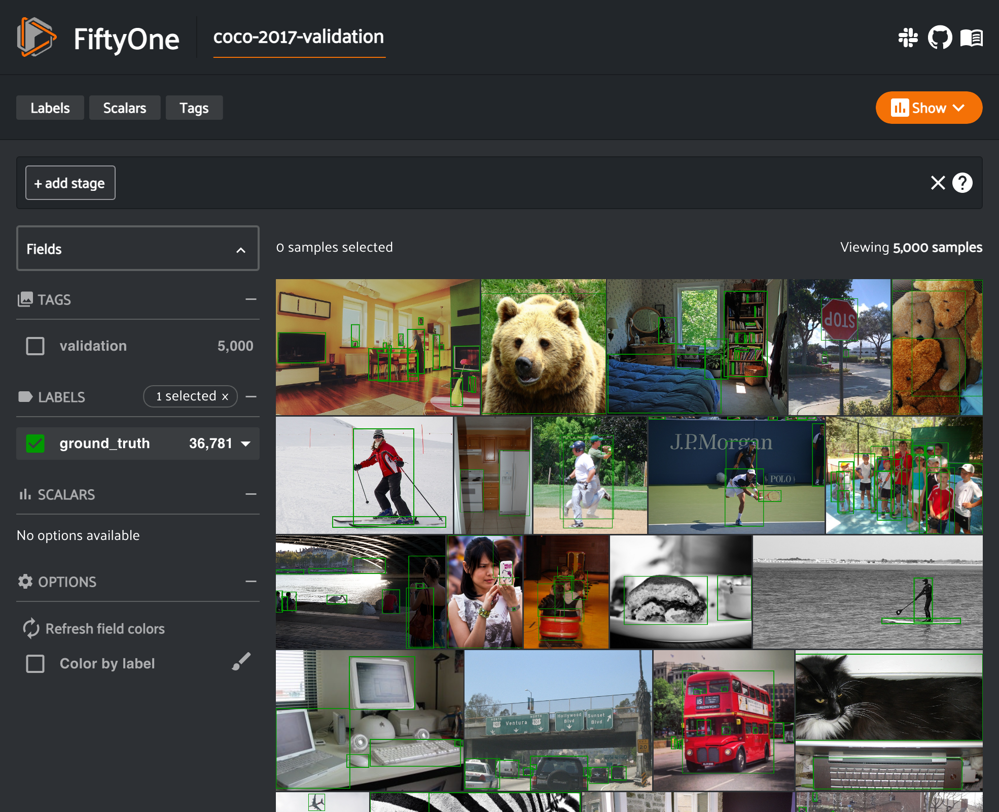

In [4]:
# Launch the App
session = fo.launch_app(dataset)

## Automatic screenshots as you work

Notebooks are great for many reasons, one of which is the ability to share your work with others. FiftyOne is designed to help you write notebooks that capture your work on visual datasets, using a feature we call **automatic screenshotting**.

Whenever you open a new App instance in a notebook cell, e.g., by updating your [Session](https://voxel51.com/docs/fiftyone/api/fiftyone.core.session.html?highlight=session#fiftyone.core.session.Session) object, any previous App instances will be automatically replaced with a static screenshot. In fact, that's what you're seeing below; screenshots of the Apps we opened when we created this notebook!

The cell below issues a [session.show()](https://voxel51.com/docs/fiftyone/api/fiftyone.core.session.html#fiftyone.core.session.Session.show) command, which opens a new App instance in the cell's output. When you run the cell for yourself, notice that the App instance in the previous cell is automatically replaced with a screenshot of its current state. You can reactivate old App instances by hovering over them and clicking anywhere.

After running the cell below, try double-clicking on an image in the grid to expand the sample.


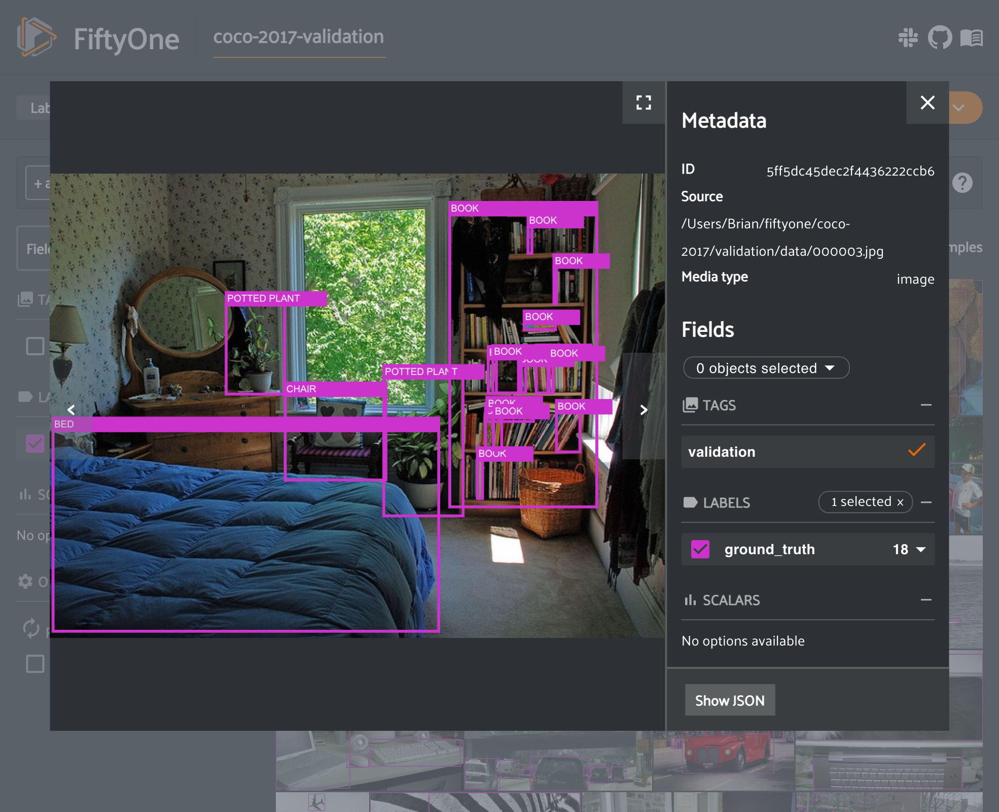

In [5]:
# Launch a new App instance
session.show()

## Using the App

With the App, you can visualize your samples and their fields either in image grid view, or by double-clicking an image to enter an expanded sample view, where you can study individual samples in more detail.

The [view bar](https://voxel51.com/docs/fiftyone/user_guide/app.html#using-the-view-bar) allows you to search and filter your dataset to study specific samples or labels of interest.

With FiftyOne, you can seemlessly transition between the App and Python.

For example, create a search using the `Shuffle()` and `Limit()` stages in the view bar:


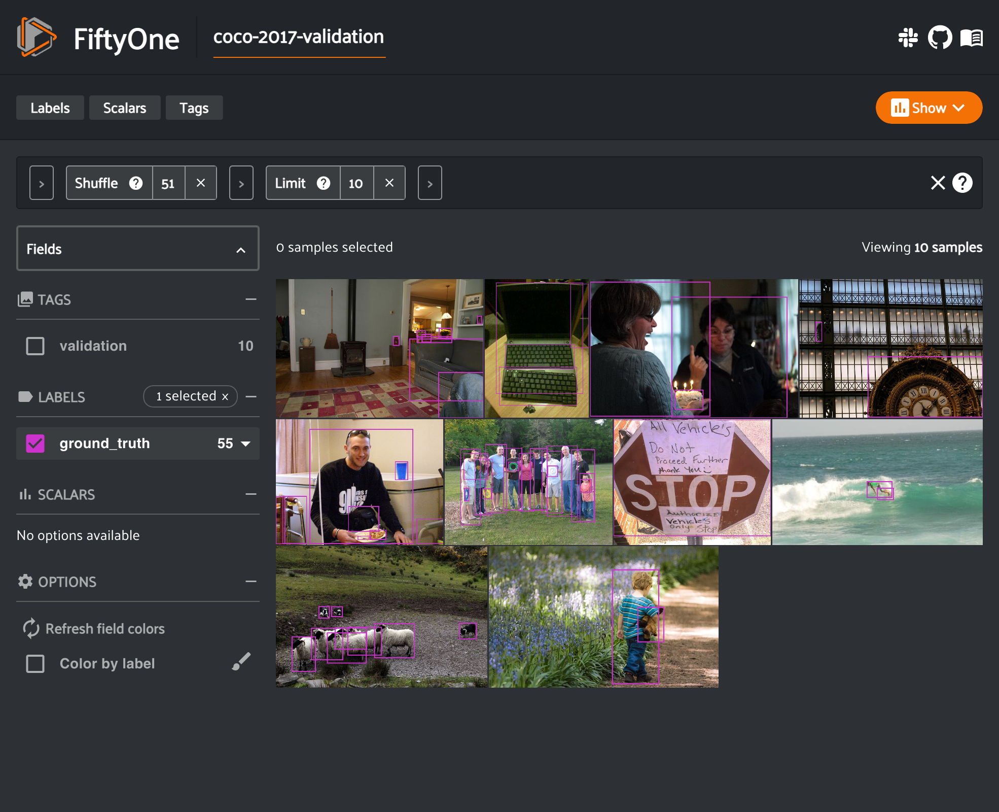

In [10]:
session.show()

You can access the current view back in your Python shell at any time:

In [13]:
# Access the current view in the App
print(session.view)

Dataset:        coco-2017-validation
Media type:     image
Num samples:    10
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
View stages:
    1. Shuffle(seed=51)
    2. Limit(limit=10)


You can also select samples in the App and access the currently selected samples from Python:


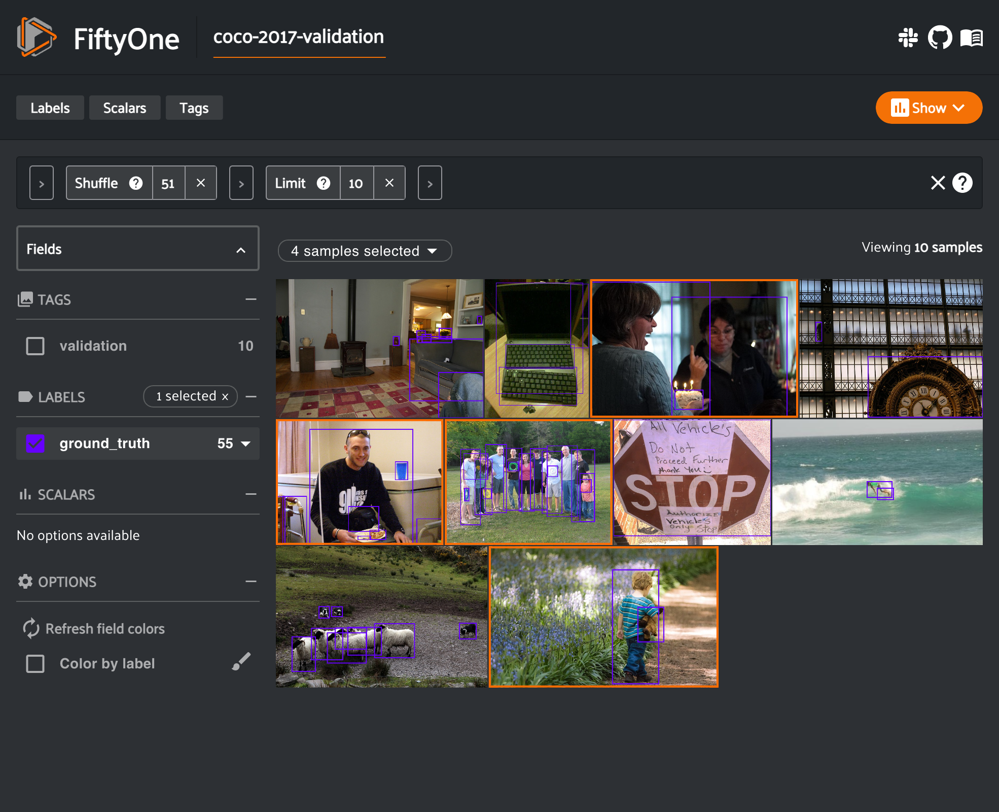

In [14]:
session.show()

In [16]:
# The currently selected samples
print(session.selected)

['5ff5dc5adec2f443622378bf', '5ff5dc51dec2f44362232ce9', '5ff5dc59dec2f44362236a22', '5ff5dc48dec2f4436222e71a']


In [18]:
# Create a view containing the currently selected samples
selected_view = dataset.select(session.selected)

print(selected_view)

Dataset:        coco-2017-validation
Media type:     image
Num samples:    4
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
View stages:
    1. Select(sample_ids=['5ff5dc5adec2f443622378bf', '5ff5dc51dec2f44362232ce9', '5ff5dc59dec2f44362236a22', ...])


## Manipulating your view in Python

You can also manipulate the App view from Python! For example, you may want to construct a complex view from code and then open it in the App!

In [19]:
from fiftyone import ViewField as F

# Hide all detections that do not have label `person`, and sort the samples to
# show those with the most people
person_view = (
    dataset
    .filter_labels("ground_truth", F("label") == "person")
    .sort_by(F("ground_truth.detections").length(), reverse=True)
)

print(person_view)

Dataset:        coco-2017-validation
Media type:     image
Num samples:    5000
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
View stages:
    1. FilterDetections(field='ground_truth', filter={'$eq': ['$$this.label', 'person']}, only_matches=False)
    2. SortBy(field_or_expr={'$size': {'$ifNull': [...]}}, reverse=True)



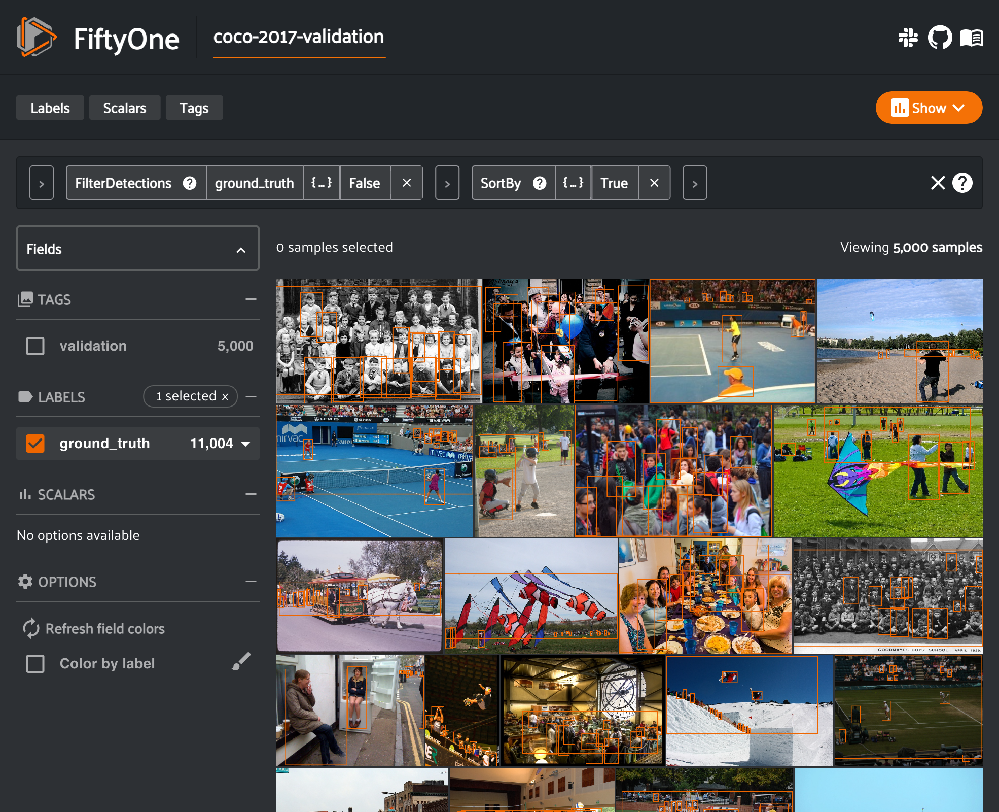

In [20]:
# Show the view in the App
session.view = person_view

## Indexing images by uniqueness

FiftyOne includes a `fiftyone.brain` package that provides a collection of algorithms to help you gain insight into your datasets and models. For more information, [check out the user guide](https://voxel51.com/docs/fiftyone/user_guide/brain.html).

Let's use the `compute_uniqueness()` function to index the samples in our dataset according to their visual uniqueness:

In [4]:
import fiftyone.brain as fob

fob.compute_uniqueness(dataset)

Loading uniqueness model...
Preparing data...
Generating embeddings...
 100% |███████████████| 5000/5000 [1.8m elapsed, 0s remaining, 47.8 samples/s]      
Computing uniqueness...


Inspecting the dataset shows that a numeric `uniqueness` field has been added to each sample, which measures its visual uniqueness with respect to the other samples in the dataset:

In [6]:
print(dataset)

Name:           coco-2017-validation
Media type:     image
Num samples:    5000
Persistent:     False
Info:           {'classes': ['0', 'person', 'bicycle', ...]}
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    uniqueness:   fiftyone.core.fields.FloatField


In [7]:
print(dataset.select_fields("uniqueness").first())

<SampleView: {
    'id': '603595da4341f5328b16ad19',
    'media_type': 'image',
    'filepath': '/Users/Brian/fiftyone/coco-2017/validation/data/000001.jpg',
    'tags': BaseList(['validation']),
    'metadata': None,
    'uniqueness': 0.44964635189053065,
}>


Let's visualize this information in the App by showing the most visually unique samples first:


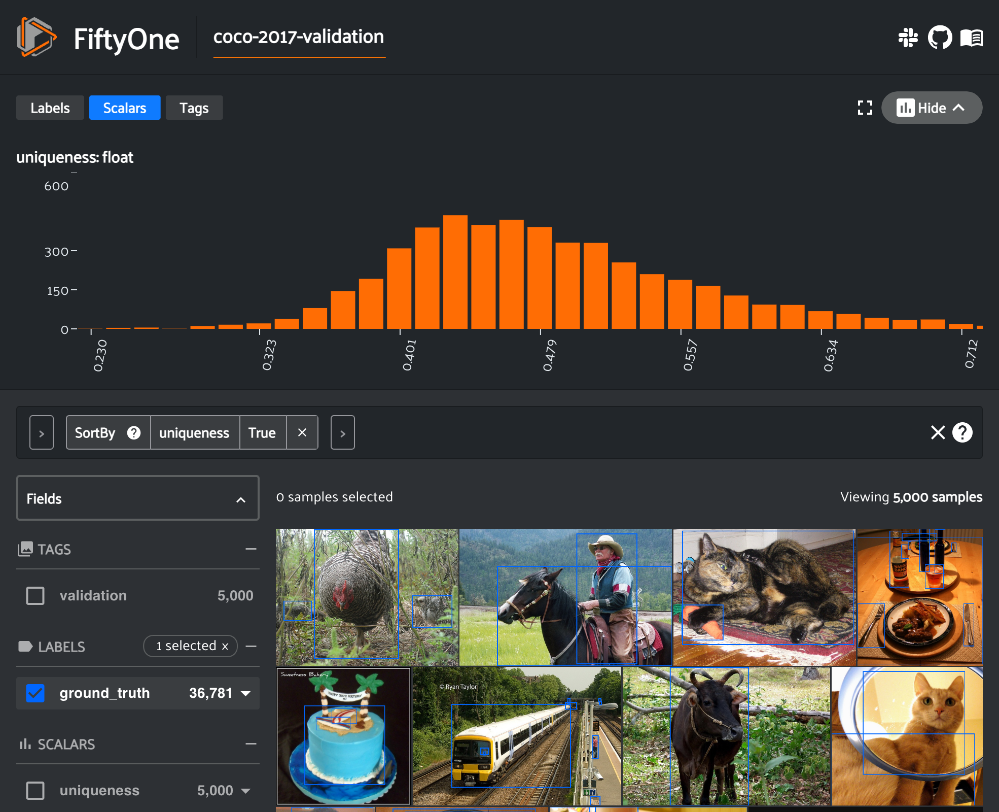

In [25]:
# Explore most unique samples
session.view = dataset.sort_by("uniqueness", reverse=True)

Sorting by **least unique** can help us identify near duplicate samples in our dataset. This can be useful in situations where you need to send a dataset for annotation and need to select a diverse set of images.


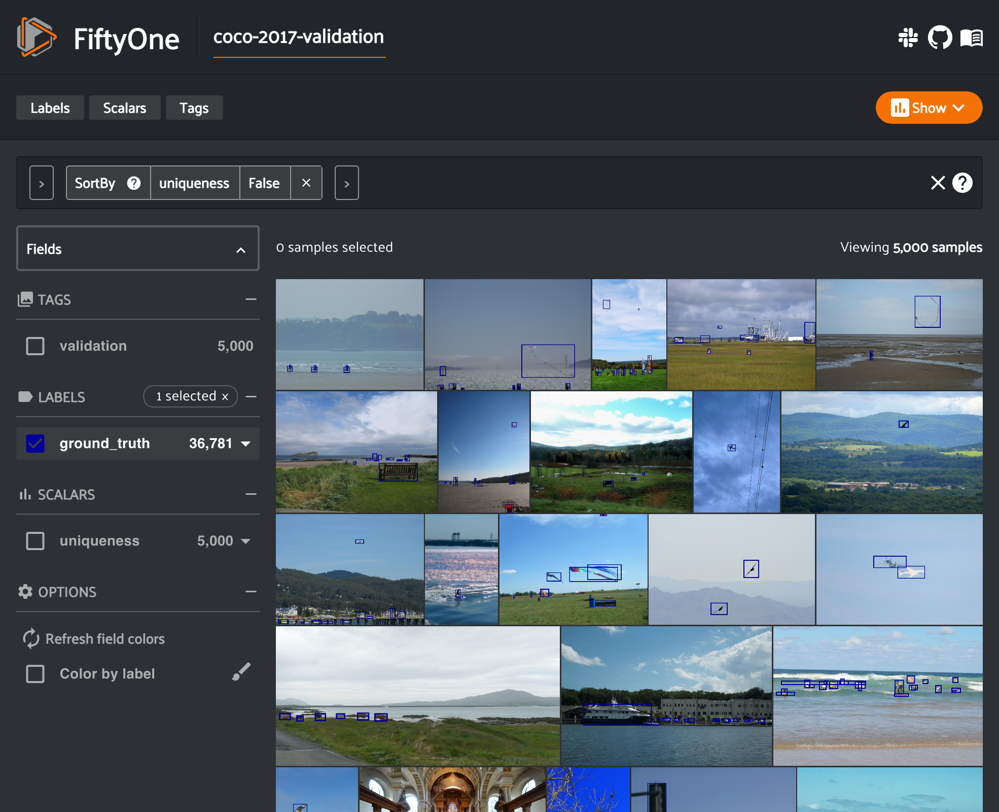

In [26]:
# Explore the least unique samples
session.view = dataset.sort_by("uniqueness")

## Adding model predictions

Now let's add some model predictions to our dataset.

First, let's select some samples to process:

In [8]:
# Select the 15 least unique samples to process
predictions_view = dataset.sort_by("uniqueness").limit(15)

print(predictions_view)

Dataset:        coco-2017-validation
Media type:     image
Num samples:    15
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    uniqueness:   fiftyone.core.fields.FloatField
View stages:
    1. SortBy(field_or_expr='uniqueness', reverse=False)
    2. Limit(limit=15)


We can access the source image at inference time via the `filepath` attribute of the samples in the view:

In [9]:
for sample in predictions_view:
    print(sample.filepath)

/Users/Brian/fiftyone/coco-2017/validation/data/001147.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/003969.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/002645.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/000035.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/004965.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/004510.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/000641.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/004329.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/000868.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/001348.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/004341.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/001614.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/004546.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/000648.jpg
/Users/Brian/fiftyone/coco-2017/validation/data/001154.jpg


FiftyOne integrates naturally with any ML framework. You simply load and perform inference with your model using your existing code, and then simply add the predictions to the corresponding samples in the dataset using FiftyOne's [Label type](https://voxel51.com/docs/fiftyone/user_guide/using_datasets.html#labels) corresponding to your task (classification, detection, etc).

In this case, we'll load a pretrained Faster R-CNN model made available by PyTorch and store the predictions in a `faster_rcnn` field of our samples:

In [10]:
from PIL import Image
import torch
import torchvision
from torchvision.transforms import functional as func


def run_inference(sample, model, device, classes):
    """Performs inference on the image at `sample.filepath` and returns the
    predictions in a `fiftyone.core.labels.Detections` instance.
    """
    # Load iamge
    img = Image.open(sample.filepath)
    img_tensor = func.to_tensor(img).to(device)
    _, height, width = img_tensor.shape

    # Perform inference
    predictions = model([img_tensor])[0]
    labels = predictions["labels"].cpu().detach().numpy()
    scores = predictions["scores"].cpu().detach().numpy()
    boxes = predictions["boxes"].cpu().detach().numpy()

    # Convert detections to FiftyOne format
    detections = []
    for label, score, box in zip(labels, scores, boxes):
        # Convert to [top-left-x, top-left-y, width, height] format with
        # relative coordinates in [0, 1] x [0, 1]
        x1, y1, x2, y2 = box
        rel_box = [
            x1 / width, y1 / height, (x2 - x1) / width, (y2 - y1) / height
        ]

        detections.append(
            fo.Detection(
                label=classes[label],
                bounding_box=rel_box,
                confidence=score,
            )
        )

    return fo.Detections(detections=detections)


# Load pre-trained model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)
_ = model.eval()

# Add model predictions to dataset
classes = dataset.info["classes"]
with fo.ProgressBar() as pb:
    for sample in pb(predictions_view):
        sample["faster_rcnn"] = run_inference(sample, model, device, classes)
        sample.save()

 100% |███████████████████| 15/15 [1.7m elapsed, 0s remaining, 0.1 samples/s]     


We can verify that predictions were added to our dataset by checking for the `faster_rcnn` field in the view's schema:

In [11]:
# The `faster_rcnn` field of the sample contains the model predictions
print(predictions_view)

Dataset:        coco-2017-validation
Media type:     image
Num samples:    15
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    uniqueness:   fiftyone.core.fields.FloatField
    faster_rcnn:  fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
View stages:
    1. SortBy(field_or_expr='uniqueness', reverse=False)
    2. Limit(limit=15)


We can recover the samples with predictions at any time by using the [Exists stage](https://voxel51.com/docs/fiftyone/api/fiftyone.core.stages.html?highlight=exists#fiftyone.core.stages.Exists)
in the view bar in the App to select samples with a value in their `faster_rcnn` field:

As usual, we can create the same view via Python code:


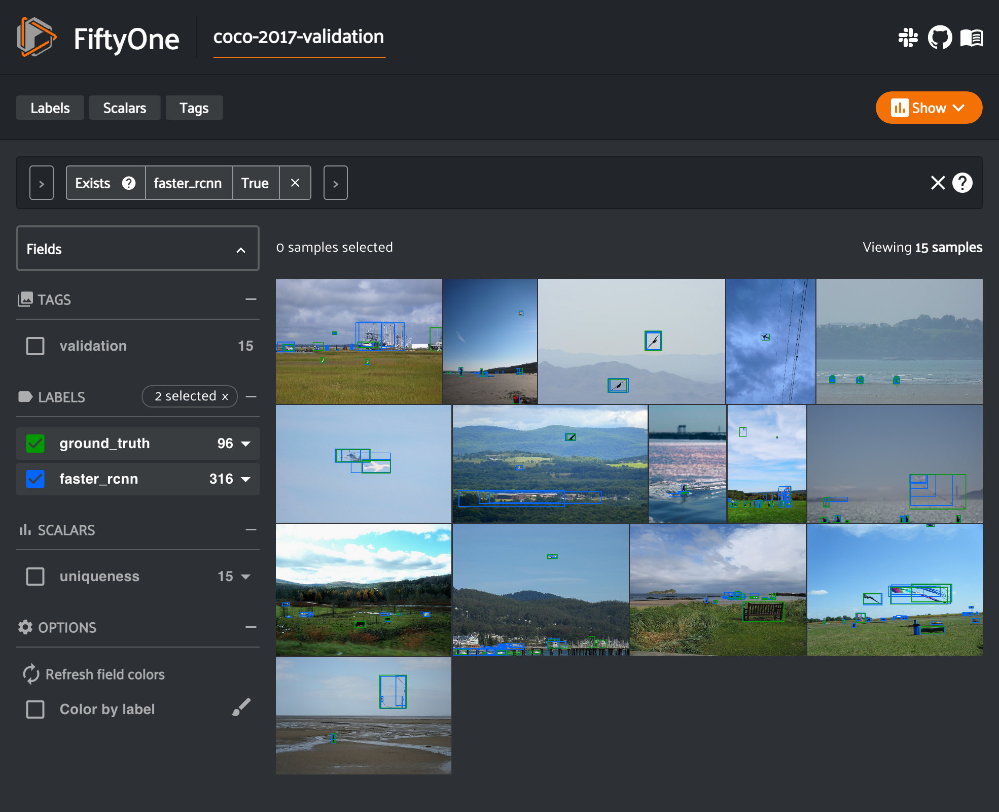

In [31]:
# Only show samples with a value in their `faster_rcnn` field
session.view = dataset.exists("faster_rcnn")

## Evaluating models

With the FiftyOne App, you can easily visualize the predictions and qualitatively compare them with the ground truth:


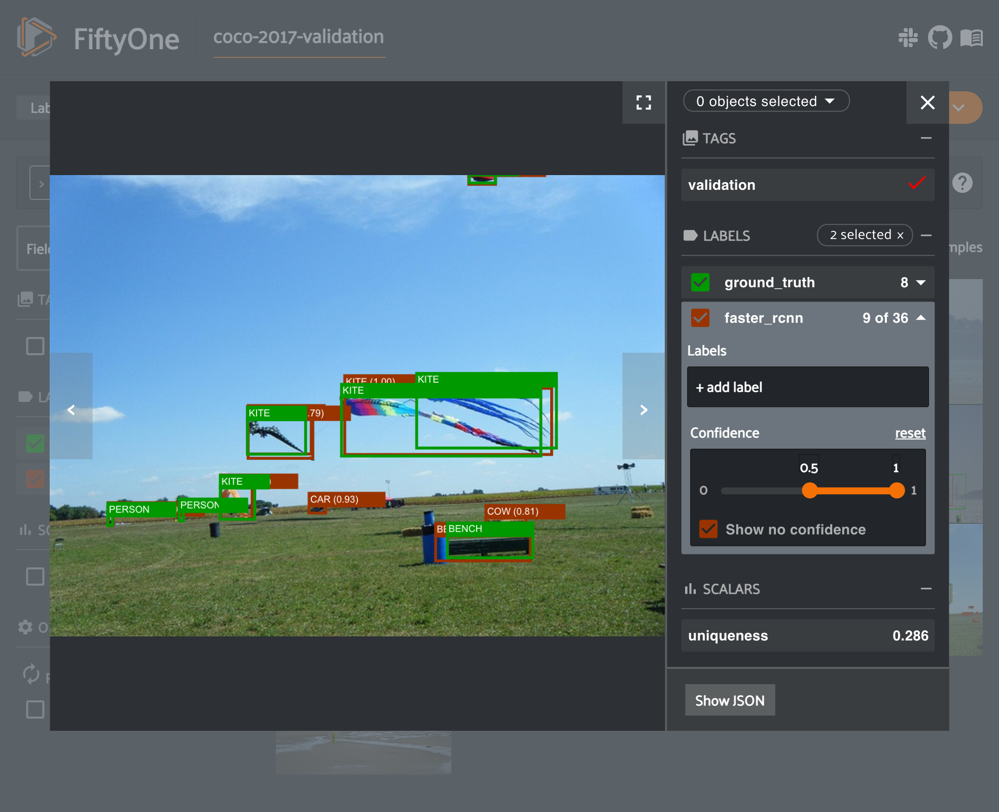

In [32]:
session.show()

However, FiftyOne also provides a powerful [evaluation framework](https://voxel51.com/docs/fiftyone/user_guide/evaluation.html) that you can use to analyze your models.

Although the evaluation framework provides support for common quantiative evaluation measures such as confusion matrices, mAP, and PR curves, aggregate metrics alone don’t give the full picture of a model's performance. In practice, the limiting factor of a model is often data quality issues that you need to **see** to address. FiftyOne is designed to make it easy to do just that.

For example, the snippet below uses the [evaluate_detections()](https://voxel51.com/docs/fiftyone/api/fiftyone.core.collections.html?highlight=evaluate_detections#fiftyone.core.collections.SampleCollection.evaluate_detections) method available on all datasets and views to perform COCO-style evaluation of the predictions, including per-sample true positives (TP), false positives (FP), and false negatives (FN):

In [25]:
# Retrieve the samples with predictions
predictions_view = dataset.exists("faster_rcnn")

# Evaluate the predictions in the `predictions` field
# w.r.t. the ground truth labels in the `ground_truth` field
results = predictions_view.evaluate_detections(
    "faster_rcnn",
    gt_field="ground_truth",
    eval_key="eval",
)

Evaluating detections...
 100% |███████████████████| 15/15 [499.0ms elapsed, 0s remaining, 30.1 samples/s]      


Refreshing the view in the App, we see that additional fields have been added to each sample to tabulate the evaluation metrics:


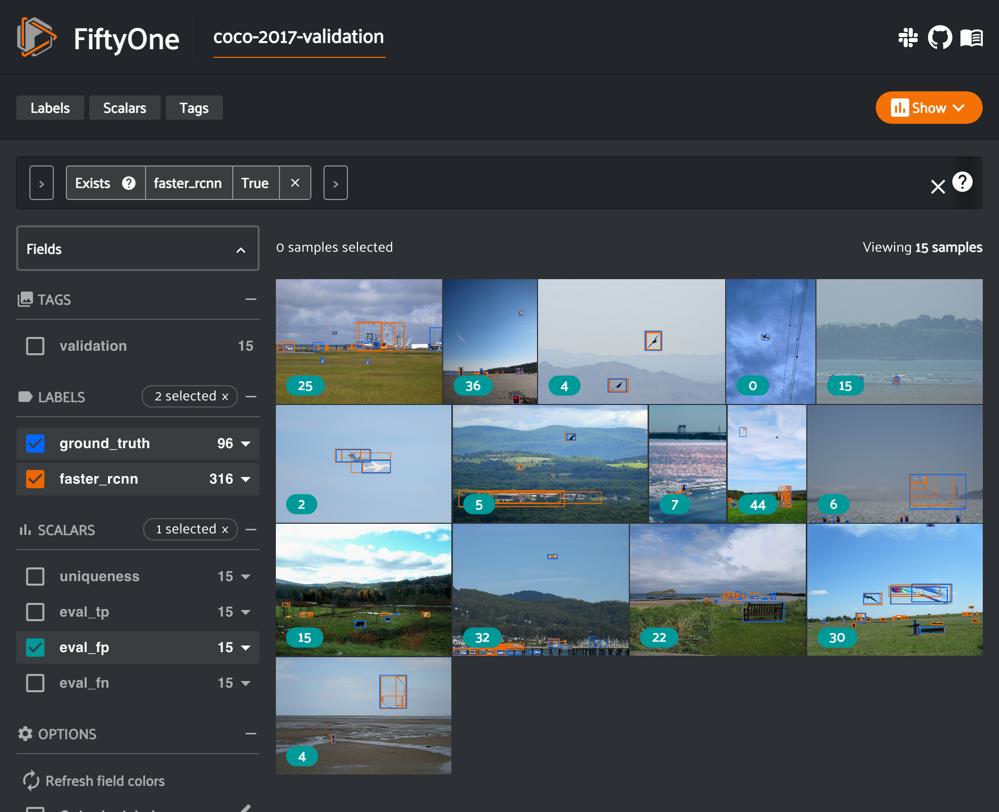

In [26]:
# Update the view in the App
session.view = predictions_view

Both visually and quantitatively, we see that the model is generating too many false positive predictions:


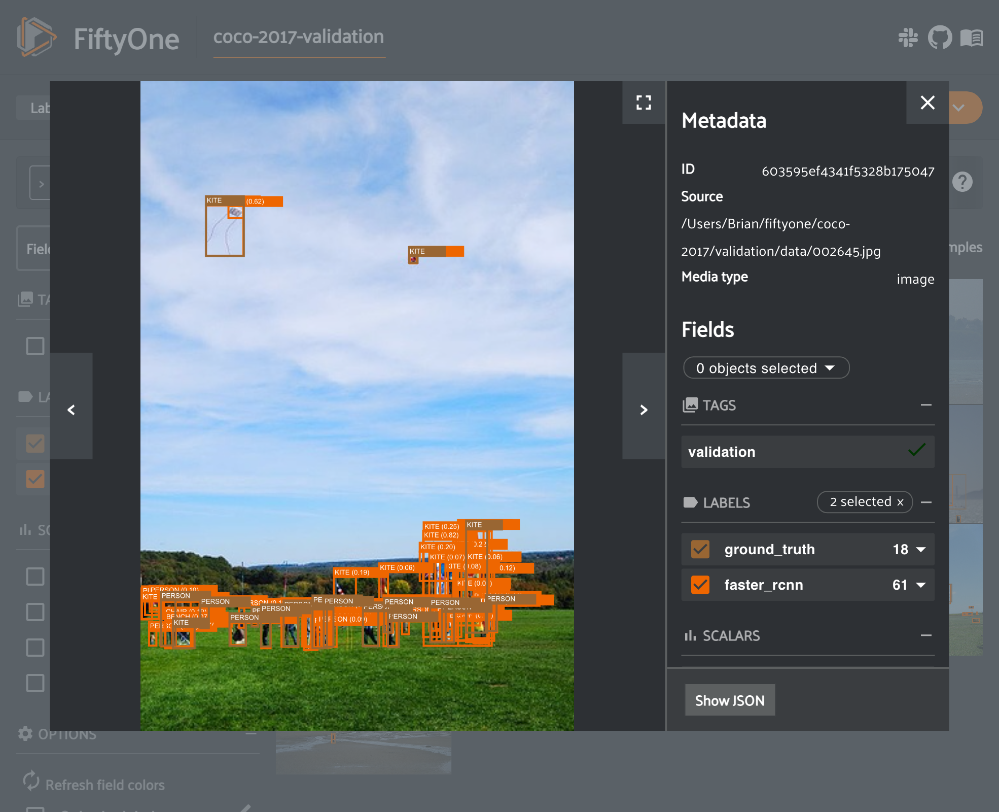

In [16]:
session.show()

Let's create a view into the dataset with FiftyOne that contains only predictions with a confidence score of at least 0.8:

In [17]:
from fiftyone import ViewField as F

# Only keep predictions whose confidence is at least 0.8
high_conf_predictions_view = predictions_view.filter_labels(
    "faster_rcnn", F("confidence") > 0.8
)

print(high_conf_predictions_view)

Dataset:        coco-2017-validation
Media type:     image
Num samples:    15
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    uniqueness:   fiftyone.core.fields.FloatField
    faster_rcnn:  fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    eval_tp:      fiftyone.core.fields.IntField
    eval_fp:      fiftyone.core.fields.IntField
    eval_fn:      fiftyone.core.fields.IntField
View stages:
    1. Exists(field='faster_rcnn', bool=True)
    2. FilterLabels(field='faster_rcnn', filter={'$gt': ['$$this.confidence', 0.8]}, only_matches=True)


Don't worry, the lower confidence predictions have not been deleted! They are just being excluded from the view.

Let's re-run the evaluation method to update the metrics for the high-confidence-only predictions:

In [21]:
# Re-evaluate
results = high_conf_predictions_view.evaluate_detections(
    "faster_rcnn",
    gt_field="ground_truth",
    eval_key="eval",
)

Evaluating detections...
 100% |███████████████████| 15/15 [378.3ms elapsed, 0s remaining, 39.6 samples/s]      



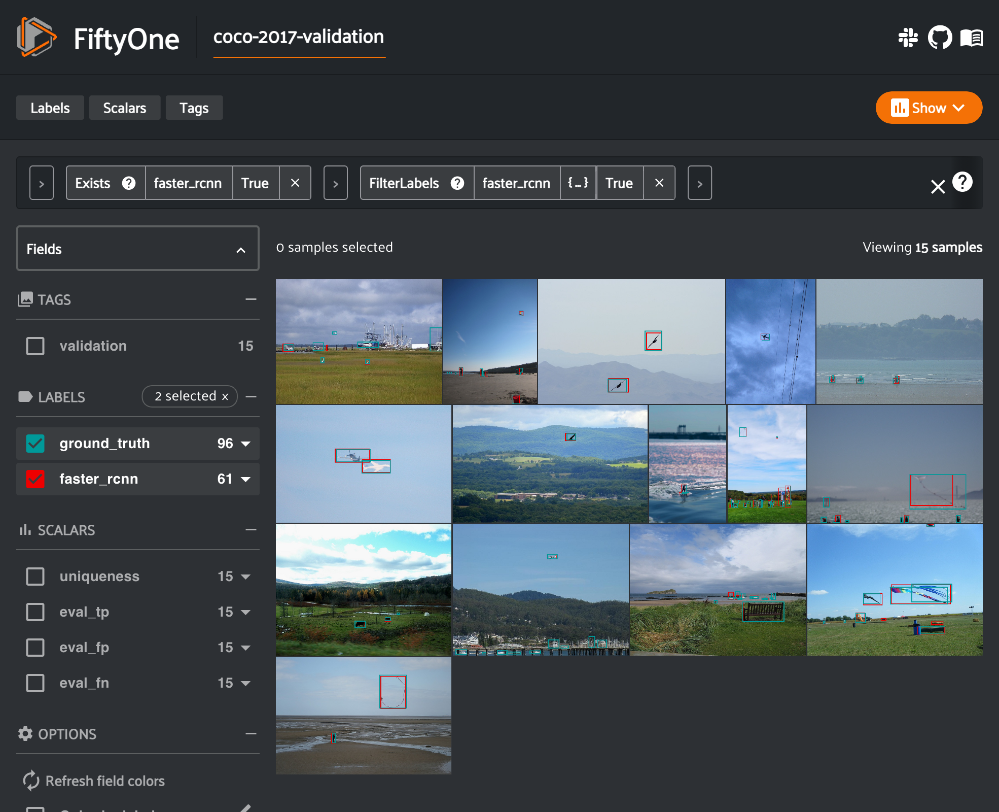

In [22]:
# Reload view in App
session.view = high_conf_predictions_view

As we can now see, both visually and quantitatively, the false positive rate of
the model has been decreased!


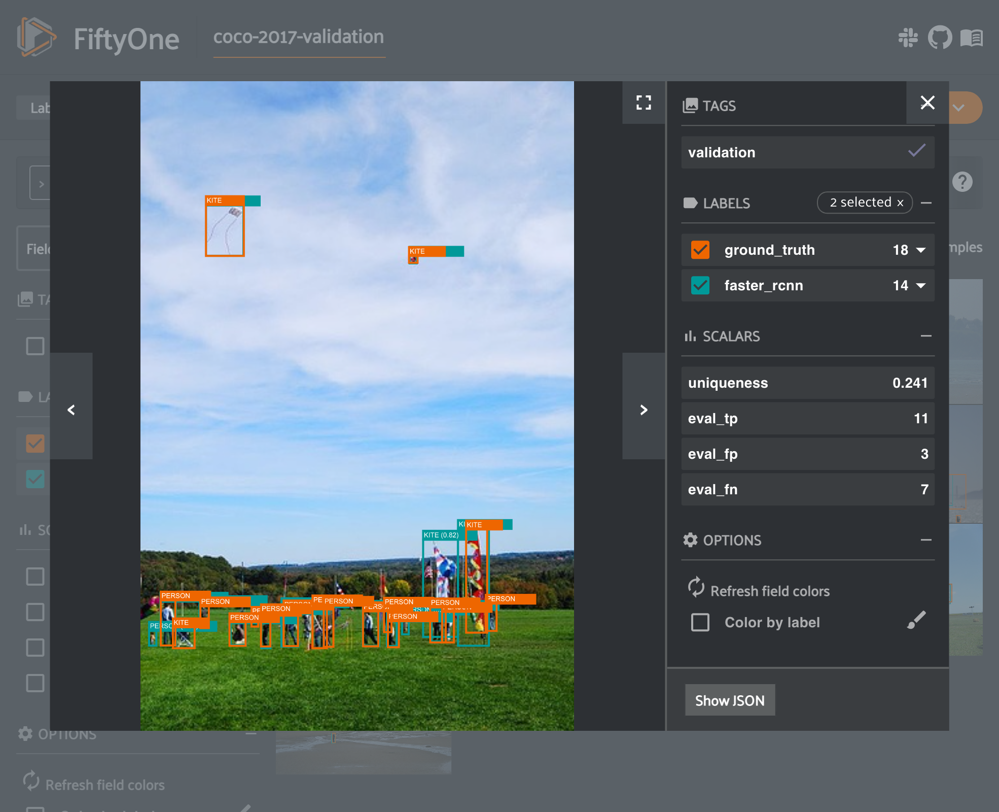

In [23]:
session.show()

## Sharing notebooks

To make a notebook ready for sharing, you'll need to screenshot the currently active App by calling [Session.freeze()](https://voxel51.com/docs/fiftyone/api/fiftyone.core.session.html#fiftyone.core.session.Session.freeze):

In [27]:
session.freeze()

Now when you share this notebook, publish it online, etc., all of your App outputs will be available for readers to see when they first open the notebook.

## Next steps

This walkthrough provided just a glimpse into the possibilities of using FiftyOne. If you'd like to learn more, check out these [tutorials](https://voxel51.com/docs/fiftyone/tutorials/index.html) and [recipes](https://voxel51.com/docs/fiftyone/recipes/index.html).

And did we mention that FiftyOne is open source? Check out the project [on GitHub](https://github.com/voxel51/fiftyone) and [leave an issue](https://github.com/voxel51/fiftyone/issues/new/choose) if you think something is missing.

Thanks for tuning in!